# Classification of Japanese art

This jupyter notebook was a project created by [@diana-fsa](https://github.com/diana-fsa)(github) at third year of college in 2020.  

## 1. Introducció

This notebook uses a dataset of images in high resolution of pieces of art from different artists.

"Can we classify art pieces by their artists?"

Below there is an exploration of the dataset and an image classifier is built to get to an answer.

## 2. Dataset

The [dataset](https://www.kaggle.com/kengoichiki/the-metropolitan-museum-of-art-ukiyoe-dataset) has "Ukiyo-e" ( a genre of woodblock prints and paintings made in Japan from the 17th through 19th centuries ) images proceding from the Metropolitan Museum of Art under the CC0 licence.

This database was inspired by the competition of Ukiyo-e's authors predicition organized by ProbSpace, where the images of the Metropolitan Museum of Art were also used. Unfortunately in the competition the images were only provided in size 234x234.

This dataset contains the original images in high resolution. Every image is in the folder with the name of its corresponding author.

There is a total of 4040 images from 50 different painters. 

This notebook focuses on the 5 authors with more paintings: Utagawa Hiroshige, Katsushika Hokusai, Katsukawa Shunsho, Kubo Shunman and Kitagawa Utamaro.

First, the starter that was provided in kaggle is used for a first approximation of the dataset:

In [1]:
from pathlib import Path
from collections import Counter
from PIL import Image
import matplotlib.pyplot as plt


 Hi ha un total de 5 autors.

Número total d'obres d'art per autor:
 [('Utagawa_Hiroshige', 668), ('Katsushika_Hokusai', 373), ('Katsukawa_Shunsho', 260), ('Kubo_Shunman', 206), ('Kitagawa_Utamaro', 200)]


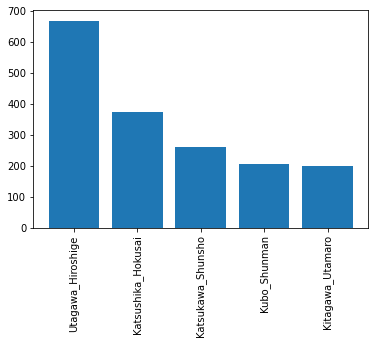


 Artistes i el seu id:
 {'Utagawa_Hiroshige': 0, 'Katsushika_Hokusai': 1, 'Katsukawa_Shunsho': 2, 'Kubo_Shunman': 3, 'Kitagawa_Utamaro': 4}


In [2]:
PATH = Path('./images')
files = sorted([str(p) for p in PATH.glob('*/*.jpg')])
labels = [p.split('\\')[-2] for p in files]
freq = Counter(labels).most_common()
artists = [d[0] for d in freq]
print("\n There is a total of", len(artists), "authors.\n")
print("Total number of pieces of art from author:\n", freq)

#plot pieces of art by author
length = len(artists)
values=[]
keys=[]
for elem in freq:
    keys.append(elem[0])
    values.append(elem[1])
plt.bar(range(length), values, align='center')
plt.xticks(range(length), keys, rotation=90)
plt.show()

artist_to_id = {c: i for i, c in enumerate(artists)}
print("\n Artists and ids:\n", artist_to_id)

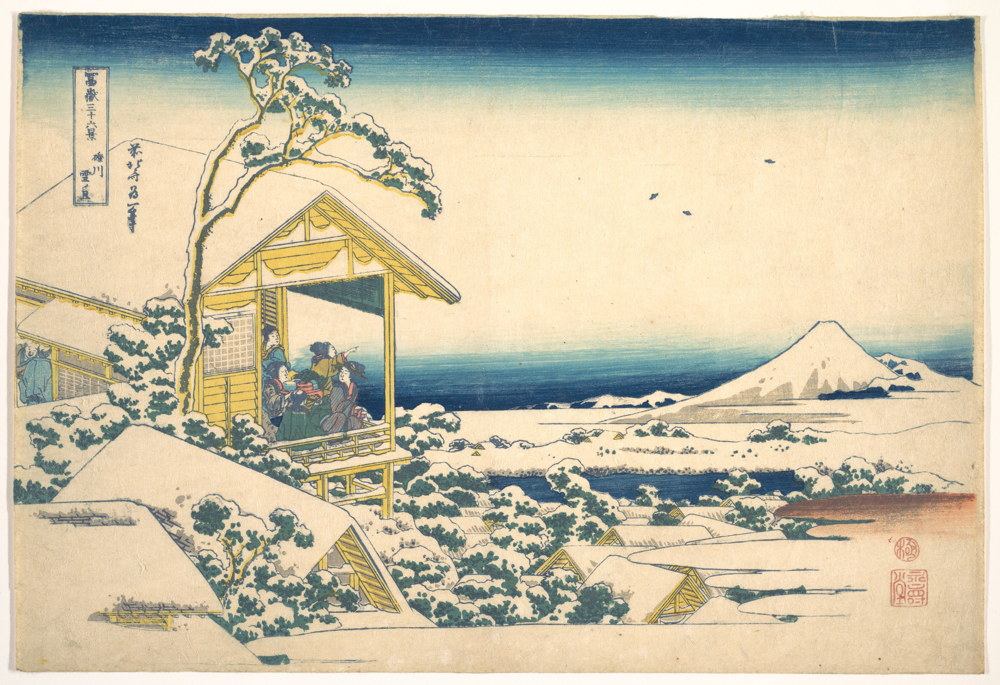

In [3]:
#To visualize any image in high resolution
Image.open(files[502])

## 3. Tests and experiments

We'll build two types of classifications:
* Classification of 5 authors
* Classification of author Utagawa Hiroshige vs. the rest

The neural network using TensorFlow was chosen as a model. The TensorFlow library combines a lot of models and computational leraning and deep learning algorithms (also known as neural network).

Here we import the libraries that will be used.

In [1]:
import tensorflow as tf
import numpy as np
import os
from tqdm import tqdm
import cv2 
from sklearn.utils import shuffle 
import pandas as pd
import math
import seaborn as sns
from sklearn.model_selection import KFold
from random import randint

In [5]:
def load_data(path, x, y):
    
    IMAGE_SIZE = (x, y)
    dataset = path
    images = []
    labels = []

    print("Loading {}".format(dataset))
    # Iterate each folder 
    for folder in os.listdir(dataset):
        label = artist_to_id[folder]
        # Iterate each image of the folder
        for file in tqdm(os.listdir(os.path.join(dataset, folder))):
            # Save path of the image
            img_path = os.path.join(os.path.join(dataset, folder), file)
            # Open and change image size
            image = cv2.imread(img_path)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image = cv2.resize(image, IMAGE_SIZE) 
            # Add image and label
            images.append(image)
            labels.append(label)
       
    images = np.array(images, dtype = 'float32')
    labels = np.array(labels, dtype = 'int32')    
    
    #shape
    print ("Each RGB image shape is: {}".format(IMAGE_SIZE))
        
    return images,labels

In [6]:
def split(X, y, shf = True): 
    # use of KFold to create a dataset (80% for training and 20% for testing)
    kf = KFold(n_splits=5, shuffle=True)
    X_train=[1,1,1,1,1]
    X_test=[1,1,1,1,1]
    y_train=[1,1,1,1,1]
    y_test=[1,1,1,1,1]
    i=0
    for train, test in kf.split(X):
        X_train[i], X_test[i], y_train[i], y_test[i] = X[train], X[test], y[train], y[test]
        i+=1
    # We use one split chosen randomly 
    idx = randint(0,4)
    train_images, train_labels, test_images, test_labels = X_train[idx], y_train[idx], X_test[idx], y_test[idx] 
    # If it's indicated, a shuffle of train and test is done
    if shf: 
        train_images, train_labels = shuffle(train_images, train_labels)
        test_images, test_labels = shuffle(test_images, test_labels)
    #print summary
    n_train = train_labels.shape[0]
    n_test = test_labels.shape[0]
    print ("Number of training examples: {}".format(n_train))
    print ("Number of testing examples: {}".format(n_test))
    return train_images, train_labels, test_images, test_labels

In [83]:
def plot_acc_loss(history, epochs):
    #graphs of accuracy, training loss and validation loss.
    acc = history.history['accuracy']
    acc_val = history.history['val_accuracy']
    loss = history.history['loss']
    loss_val = history.history['val_loss']
    epochs_range = range(epochs)
    
    plt.figure(figsize=(16, 8))
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label="train_acc")
    plt.plot(epochs_range, acc_val, label="val_acc")
    plt.axis( ymin=0, ymax=1.1)
    plt.title('Accuracy')
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label="train_loss")
    plt.plot(epochs_range, loss_val, label="val_loss")
    plt.title('Loss')
    plt.legend()
    plt.show()

In [8]:
def visualize_confusion_matrix(labels, predictions):
    #show the confusion matrix
    cm = tf.math.confusion_matrix(labels, predictions)
    plt.subplots(figsize=(10, 6))
    sns.heatmap(cm, annot = True)
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.title("Confusion Matrix")
    plt.show()

In [9]:
def show_random_images(n, class_names, images, labels, scaled=False):
    #Show the n random images of the images array and its corresponding label of the label array
    if not scaled: images = images / 255.0 
    fig = plt.figure(figsize=(10,10))
    fig.suptitle("Several examples of images in the dataset", fontsize=17)
    for i in range(n):
        index = np.random.randint(images.shape[0])
        plt.subplot(math.floor(n**(1/2)),math.ceil(n**(1/2)),i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(images[index], cmap=plt.cm.binary)
        plt.xlabel(class_names[labels[index]])
    plt.show()

In [10]:
def plot_image(i, predictions_array, true_label, img, artists):
  true_label, img = true_label[i], img[i]/255
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])
  plt.imshow(img, cmap=plt.cm.binary)
  predicted_label = np.argmax(predictions_array)
  if predicted_label == true_label:
    color = 'green'
  else:
    color = 'red'
  plt.xlabel("{} ({})".format(artists[predicted_label], artists[true_label]), color=color)


def plot_correct(predictions, test_labels, test_images, artists):
    # Plot the first X images of the test_images array, its predicted label and between brackets its real label
    # If the prediciton is correct we use green and if it's incorrect we use red
    num_rows = 5
    num_cols = 3
    num_images = num_rows*num_cols
    plt.figure(figsize=(2*2*num_cols, 2*num_rows))
    for i in range(num_images):
      plt.subplot(num_rows, 2*num_cols, 2*i+1)
      plot_image(i, predictions[i], test_labels, test_images, artists)
    plt.tight_layout()
    plt.show()

Before building the classifiers we save the images in 300x300.

In [11]:
X,y = load_data(PATH, 300, 300)

  0%|▎                                                                                 | 1/260 [00:00<00:28,  9.05it/s]

Loading C:\Users\Diana\Documents\UAB\3r CURS\APRENENTATGE COMPUTACIONAL\kaggle\archive\images


100%|████████████████████████████████████████████████████████████████████████████████| 668/668 [01:26<00:00,  7.74it/s]


Each RGB image shape is: (300, 300)


We visualize some of the images of the dataset:

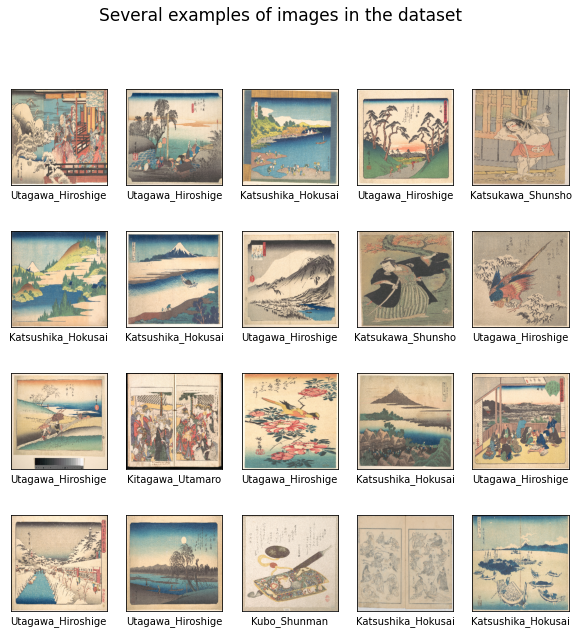

In [12]:
show_random_images(20, artists, X, y)

In the next step we distinguish between each type of classification.

### Classification of 5 authors

We separate the data in 80% training and 20% testing.

In [12]:
train_images, train_labels, test_images, test_labels = split(X, y)

Number of training examples: 1366
Number of testing examples: 341


And we check how many images there are for trining and how many for testing of each author.

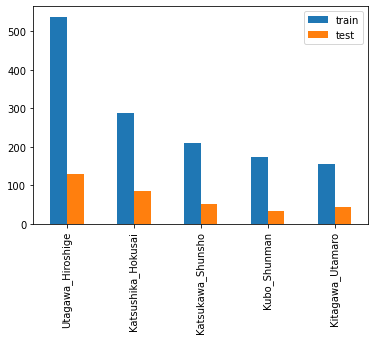

In [13]:
train_labels_unique, train_counts = np.unique(train_labels, return_counts = True)
test_labels_unique, test_counts = np.unique(test_labels, return_counts = True)
pd.DataFrame({'train': train_counts, 'test': test_counts}, index = artists).plot.bar()
plt.show()

Once we have the data prepared we create the model that will be used:

In [2]:
#model and layers
num_artists=5

model_1 = tf.keras.Sequential([
    #The first convulation layer will learn 16 filters of 5x5, apply 2x2 strides for reducing the spacial dimension 
    #and won't use padding
    tf.keras.layers.Conv2D(16, (5, 5), strides=(2, 2), padding='valid', input_shape=(300, 300, 3), activation='relu'),
    #The second convulation layer has 32 filters of 3x3 with padding
    tf.keras.layers.Conv2D(32, (3, 3), padding='same', activation='relu'),
    #The MaxPooling layer will reduce the size of the data, the parameter number, the computation that is needed
    #ans also it will control the overfitting
    tf.keras.layers.MaxPooling2D(2, 2),
    #The BatchNormalization layer does a normalization that is good against the overffiting
    tf.keras.layers.BatchNormalization(),
    #the dropout layer will prevent overfitting setting random weigths to 0
    tf.keras.layers.Dropout(0.35),
    #the flatten layer changes the size of the input to a vector with 1 dimension
    tf.keras.layers.Flatten(),
    #we add one fully connected layer with 238 nodes
    tf.keras.layers.Dense(238, activation='relu'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.5),
    #as the last layer we have a Dense layer with as many nodes as classes to classify (5)
    tf.keras.layers.Dense(num_artists, activation='softmax')
]) 


To summarize we have the next layers:
* Convulation layer of 16 filters 5x5 + 2x2 strides
* Convulation layer of 32 filtres 3x3 + padding
* MaxPooling layer 2x2
* BatchNormalization layer
* Dropout of 0.35
* Flatten
* Fully connected layer (Dense) with 238 nodes
* BatchNormalization layer
* Dropout of 0.5
* Dense layer of 5 nodes

The first layer is used because the images are saved with a big size.

The layers MaxPooling, BatchNormalization and Dropout will be used to keep on check the overfitting.

As a compiler we use the 'Adam' optimizer that is a stochastic gradient descend method and as a loss function we use 'sparse_categorical_crossentropy'  that dies crossentropy for numeric categories: 

In [32]:
model_1.compile(optimizer='adam', loss = 'sparse_categorical_crossentropy', metrics=['accuracy'])



The model is trained for 25 epochs.

In [33]:
#Train the model

history = model_1.fit(train_images, train_labels, validation_data=(test_images, test_labels), epochs = 25)


Train on 1366 samples, validate on 341 samples
Epoch 1/25
1366/1366 [==============================] - 45s 33ms/sample - loss: 1.4680 - accuracy: 0.6142 - val_loss: 60.3406 - val_accuracy: 0.1320
Epoch 2/25
1366/1366 [==============================] - 44s 32ms/sample - loss: 0.8446 - accuracy: 0.7291 - val_loss: 30.4874 - val_accuracy: 0.4399
Epoch 3/25
1366/1366 [==============================] - 45s 33ms/sample - loss: 0.6118 - accuracy: 0.8097 - val_loss: 34.1866 - val_accuracy: 0.3812
Epoch 4/25
1366/1366 [==============================] - 41s 30ms/sample - loss: 0.4635 - accuracy: 0.8485 - val_loss: 1.3865 - val_accuracy: 0.6569
Epoch 5/25
1366/1366 [==============================] - 40s 29ms/sample - loss: 0.2422 - accuracy: 0.9217 - val_loss: 1.9534 - val_accuracy: 0.6979
Epoch 6/25
1366/1366 [==============================] - 40s 29ms/sample - loss: 0.1991 - accuracy: 0.9466 - val_loss: 1.6640 - val_accuracy: 0.5484
Epoch 7/25
1366/1366 [==============================] - 40s 30

The accuracy with the test data is the following:

In [34]:
test_loss, test_acc = model_1.evaluate(test_images, test_labels, verbose=2)

print('\nTest accuracy:', test_acc)


341/341 - 2s - loss: 0.8705 - accuracy: 0.7889

Test accuracy: 0.7888563


The fact that the test accuracy is smaller that the train accuracy can be because even if the pieces of art are from the same author they can be very different from one another, or because there are different authors that have a similar paintíng style. The difference between the test and train accuracy also indicates the degree of overfitting.


And these are the training accuracy and loss graphs:

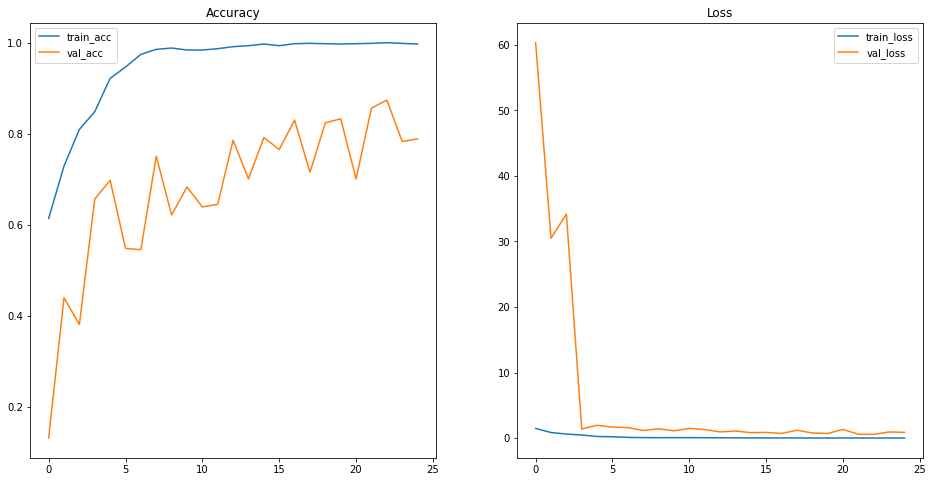

In [35]:
plot_acc_loss(history, 25)

As the val accuracy isn't very far from the train accuracy, we know that there isn't a lot of overfitting. The loss diminishes suddenly and then ovr the next epochs it doesn't change much.

We obtain the predictions and we show the confusion matrix:

In [36]:

probability_model = tf.keras.Sequential([model_1, tf.keras.layers.Softmax()])
predictions = probability_model.predict(test_images)


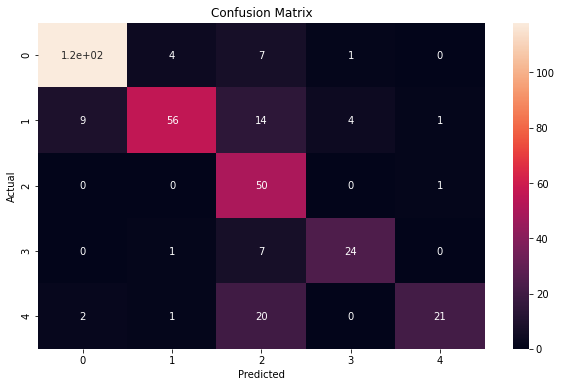

In [38]:
visualize_confusion_matrix(test_labels, np.argmax(predictions, axis=1))

In [21]:
artist_to_id

{'Utagawa_Hiroshige': 0,
 'Katsushika_Hokusai': 1,
 'Katsukawa_Shunsho': 2,
 'Kubo_Shunman': 3,
 'Kitagawa_Utamaro': 4}

We can see that in general the biggest number of predictions have been correct.

The author 4 is Kitagawa Utamaro, tha author of which we have less pieces of art in our dataset. That's why it's not unusual that it's the author that the prediciton has been more wrong about. Also, there are paintings of other artists similar to his. 

We show the first 15 predicitons:

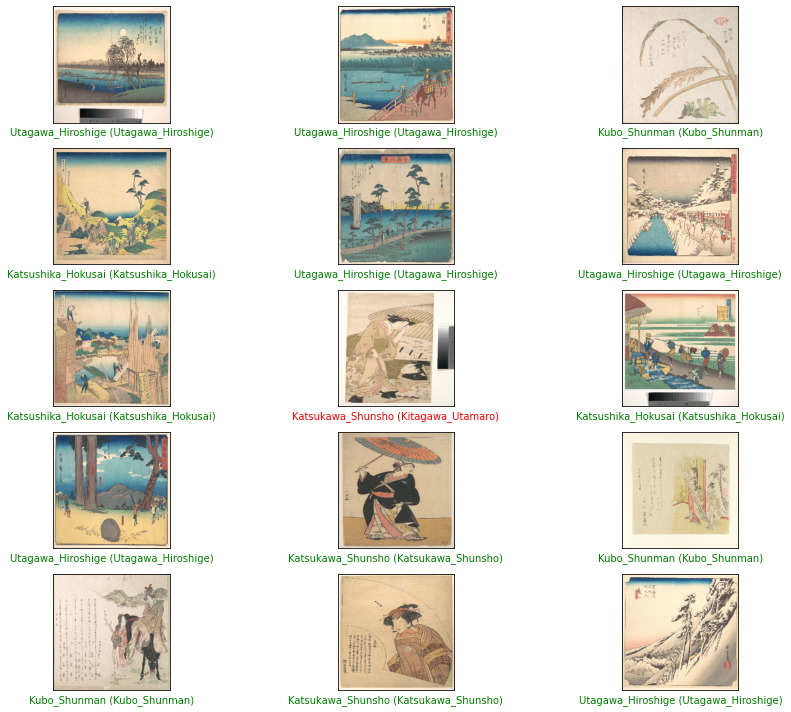

In [39]:
plot_correct(predictions, test_labels, test_images, artists)

We can see that there are pieces of art that have a similar painting style but are from different artists. And that's why some images are not classified well.

### Classification of the author Utagawa Hiroshige vs. the rest

In the following part the classifier to predict if a painting is from Utagawa Hiroshige or the rest of the artist is build:

The author Utagawa Hiroshige is the artist with more pieces of art (668), so I thought that in this classification there would be better results.

First, le'ts change the labels 1,2,3 and 4 to 1.

In [40]:
X_UH = X
y_UH = y
y_UH[np.where(y!=0)] = 1
artists_UH = ['Utagawa_Hiroshige', 'Altre']

Now we divide the data in 80% for training and 20% for testing.

In [41]:
train_images_UH, train_labels_UH, test_images_UH, test_labels_UH = split(X_UH, y_UH)

Number of training examples: 1366
Number of testing examples: 341


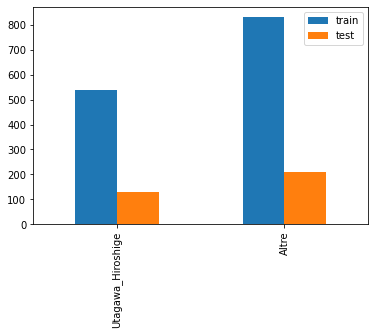

In [42]:
train_labels_unique, train_counts = np.unique(train_labels_UH, return_counts = True)
test_labels_unique, test_counts = np.unique(test_labels_UH, return_counts = True)
pd.DataFrame({'train': train_counts, 'test': test_counts}, index = artists_UH).plot.bar()
plt.show()

Then, the model used before in the classification is also used here but with less nodes in the fully connected layer.

In [68]:
#model and layers
num_artists=2

model_2 = tf.keras.Sequential([
    #The first convulation layer will learn 16 filters of 5x5, apply 2x2 strides for reducing the spacial dimension 
    #and won't use padding
    tf.keras.layers.Conv2D(16, (5, 5), strides=(2, 2), padding='valid', input_shape=(300, 300, 3), activation='relu'),
    #The second convulation layer has 32 filters of 3x3 with padding
    tf.keras.layers.Conv2D(32, (3, 3), padding='same', activation='relu'),
    #The MaxPooling layer will reduce the size of the data, the parameter number, the computation that is needed
    #ans also it will control the overfitting
    tf.keras.layers.MaxPooling2D(2, 2),
    #The BatchNormalization layer does a normalization that is good against the overffiting
    tf.keras.layers.BatchNormalization(),
    #the dropout layer will prevent overfitting setting random weigths to 0
    tf.keras.layers.Dropout(0.35),
    #the flatten layer changes the size of the input to a vector with 1 dimension
    tf.keras.layers.Flatten(),
    #we add one fully connected layer with 138 nodes
    tf.keras.layers.Dense(138, activation='relu'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.5),
    #as the last layer we have a Dense layer with as many nodes as classes to classify (2)
    tf.keras.layers.Dense(num_artists, activation='softmax')
]) 


To summarize we have the next layers:
* Convulation layer of 16 filters 5x5 + 2x2 strides
* Convulation layer of 32 filtres 3x3 + padding
* MaxPooling layer of 2x2
* BatchNormalization layer
* Dropout of 0.35
* Flatten
* Fully connected layer (Dense) with 138 nodes
* BatchNormalization layer
* Dropout of 0.5
* Dense layer of 2 nodes

As we said before, the first layer will be used because the images are saved in a big size and the layers MaxPooling, BatchNormalization and Dropout will be used to control overfitting.

The compiler is the same one as the first classifier: 

In [69]:

model_2.compile(optimizer='adam', loss = 'sparse_categorical_crossentropy', metrics=['accuracy'])


We train the model with 25 epochs and we show the results:

In [70]:
#Train the model

history2 = model_2.fit(train_images_UH, train_labels_UH, validation_data=(test_images_UH, test_labels_UH), epochs = 25)


Train on 1366 samples, validate on 341 samples
Epoch 1/25
1366/1366 [==============================] - 41s 30ms/sample - loss: 0.5813 - accuracy: 0.7899 - val_loss: 14.2396 - val_accuracy: 0.6569
Epoch 2/25
1366/1366 [==============================] - 42s 31ms/sample - loss: 0.3396 - accuracy: 0.8682 - val_loss: 7.6338 - val_accuracy: 0.6540
Epoch 3/25
1366/1366 [==============================] - 42s 31ms/sample - loss: 0.2579 - accuracy: 0.8982 - val_loss: 5.0266 - val_accuracy: 0.6158
Epoch 4/25
1366/1366 [==============================] - 41s 30ms/sample - loss: 0.1353 - accuracy: 0.9590 - val_loss: 1.5027 - val_accuracy: 0.6979
Epoch 5/25
1366/1366 [==============================] - 42s 31ms/sample - loss: 0.1095 - accuracy: 0.9612 - val_loss: 1.3054 - val_accuracy: 0.7331
Epoch 6/25
1366/1366 [==============================] - 44s 32ms/sample - loss: 0.0794 - accuracy: 0.9766 - val_loss: 0.5634 - val_accuracy: 0.8622
Epoch 7/25
1366/1366 [==============================] - 43s 32ms

Obtenim l'accuracy de la part de test:

In [71]:
test_loss2, test_acc2 = model_2.evaluate(test_images_UH,  test_labels_UH, verbose=2)

print('\nTest accuracy:', test_acc2)


341/341 - 2s - loss: 0.4935 - accuracy: 0.9238

Test accuracy: 0.9237537


With this classifier the test and train accuracy aren't very different. That's because we have many more training instances for each class and it's easier to find differences. Also, the Utagawa Hiroshige paintings have a painting style easier to recognize than those of the rest of artists.

We observe the loss and training accuracy graphs:

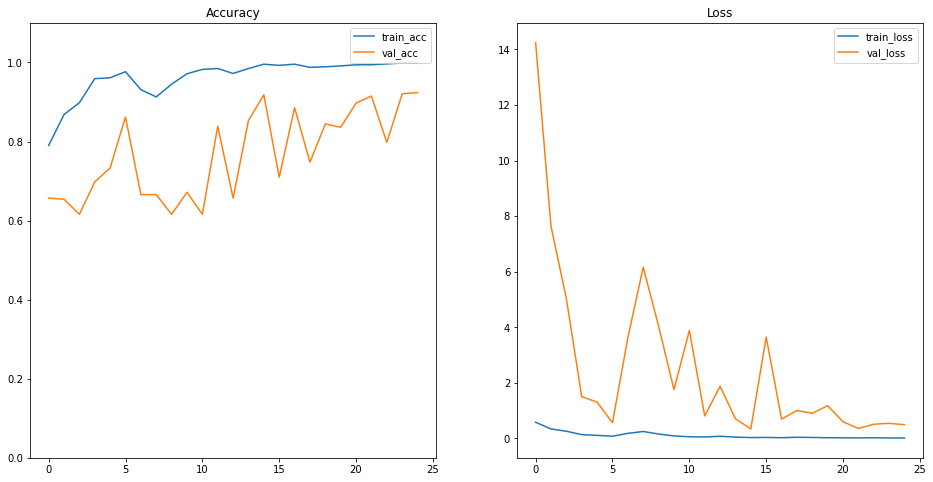

In [84]:
plot_acc_loss(history2, 25)

The val accuracy is quite close to the training accuracy, so there is not much overfitting. But the val loss has need more than 15 epochs to stabilize a bit.

We calculate the predictions from the probabilities and we show the confusion matrix:

In [85]:
probability_model2 = tf.keras.Sequential([model_2, tf.keras.layers.Softmax()])
predictions2 = probability_model2.predict(test_images_UH)

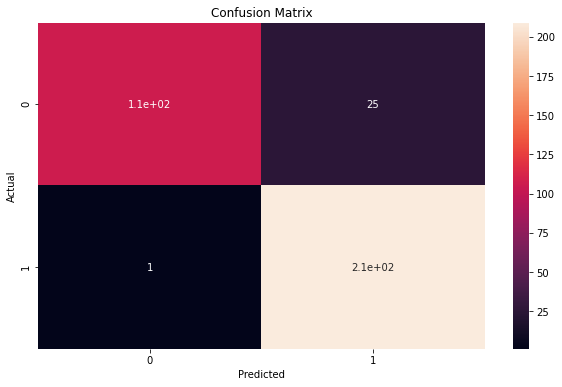

In [86]:
visualize_confusion_matrix(test_labels_UH, np.argmax(predictions2, axis=1))

There has been 25 pieces of art classified as 'other artist' that were from Utagawa Hiroshige and 1 painting classified as 'Utagawa Hiroshige' that was from another artist. A possible cause could have been that there was an autist that used a similar painting style to Utagawa Hiroshige's one, or the contrary, that some pieces of art from Utagawa Hiroshige were similar to some paintings of another artist. 

First 15 predictions, that can corroborate that the bad classified paintings had similar painting styles:

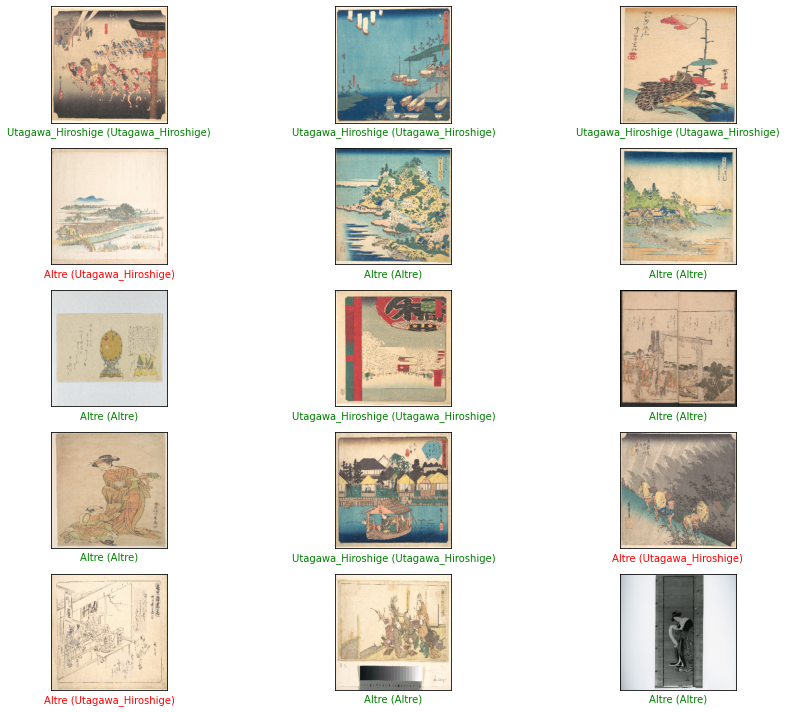

In [75]:
plot_correct(predictions2, test_labels_UH, test_images_UH, artists_UH)

As we can see, the Utagawa Hiroshige's paintings are more easy to recognize, but still some pieces of art differ from the rest and are more similar to those of other artists.

### 4. Conclusions

I changed the models many times to try to get better results and to try to be able to interpret them. I obtained good results for both classifiers, but I had some doubts when I had to explain them using the accuracy and loss graphs.

With this project I learnt to use the TensorFlow library and to see that it's possible to classify paintings by their artists.

A possible improvement could be to use more pieces of art for the training. And it would be very interesting to work with images of bigger size from the one I used, to see if it would improve the results.